## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

In [2]:
# Camera calibration matrix and distortion coefficients
def calibration_coefficients(images):
    """
    Computes the camera calibration matrix and distortion coefficients 
    given a set of chessboard images
    """
    
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((6*9, 3), np.float32)
    objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.
    
    # Step through the list and search for chessboard corners
    for fname in images:
        img = cv2.imread(fname)
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

        # If found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)
    
    return objpoints, imgpoints

In [3]:
# Apply a distortion correction to raw images.
def apply_correction(img, objpoints, imgpoints):
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[0:2], None, None)
    return cv2.undistort(img, mtx, dist, None, mtx)

In [4]:
def plot_images(images, figsize=(24, 9)):
    """Plot images helper."""
    
    f, (ax1, ax2) = plt.subplots(1, len(images), figsize=figsize)
    f.tight_layout()
    
    ax1.imshow(images[0][0])
    ax1.set_title(images[0][1], fontsize=50)
    ax2.imshow(images[1][0], cmap='gray')
    ax2.set_title(images[1][1], fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

def plot_gray_two_images(images, figsize=(24, 9)):
    """Plot images helper."""
    
    f, (ax1, ax2) = plt.subplots(1, len(images), figsize=figsize)
    f.tight_layout()
    
    ax1.imshow(images[0][0], cmap='gray')
    ax1.set_title(images[0][1], fontsize=50)
    ax2.imshow(images[1][0], cmap='gray')
    ax2.set_title(images[1][1], fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
def plot_gray_images(images, figsize=(24, 9)):
    """Plot images helper."""
    
    f, (ax1, ax2, ax3) = plt.subplots(1, len(images), figsize=figsize)
    f.tight_layout()
    
    ax1.imshow(images[0][0], cmap='gray')
    ax1.set_title(images[0][1], fontsize=50)
    ax2.imshow(images[1][0], cmap='gray')
    ax2.set_title(images[1][1], fontsize=50)
    ax3.imshow(images[2][0], cmap='gray')
    ax3.set_title(images[2][1], fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [5]:
chessboard_images = glob.glob('camera_cal/calibration*.jpg')
objpoints, imgpoints = calibration_coefficients(chessboard_images)

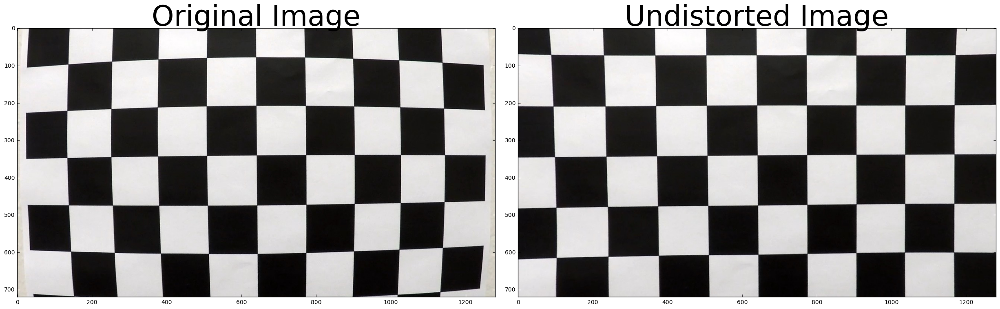

In [6]:
cal1_image = mpimg.imread('camera_cal/calibration1.jpg')
cal1_undist = apply_correction(cal1_image, objpoints, imgpoints)

# Display original an undistorted images
plot_images([[cal1_image, 'Original Image'], [cal1_undist, 'Undistorted Image']])

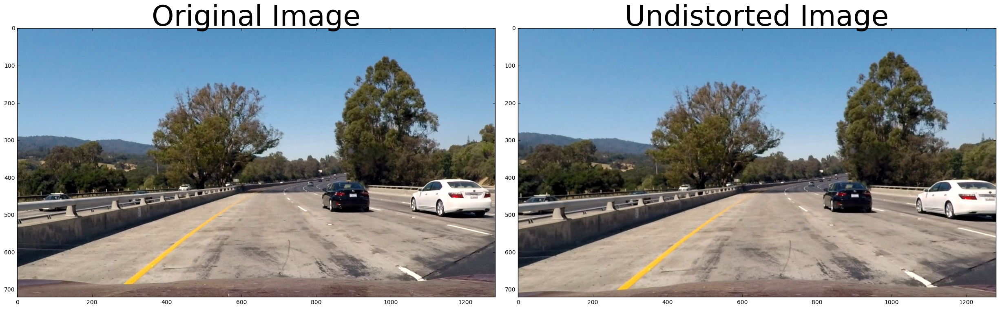

In [7]:
test1_image = mpimg.imread('test_images/test1.jpg')
test1_undist = apply_correction(test1_image, objpoints, imgpoints)

# Display original an undistorted images
plot_images([[test1_image, 'Original Image'], [test1_undist, 'Undistorted Image']])

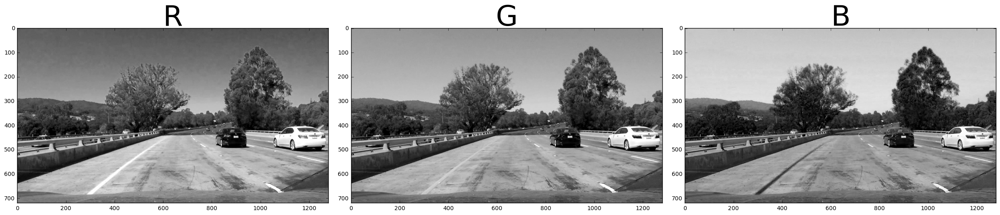

In [8]:
# Display image channels
plot_gray_images([[test1_image[:,:,0], 'R'], [test1_image[:,:,1], 'G'], [test1_image[:,:,2], 'B']])

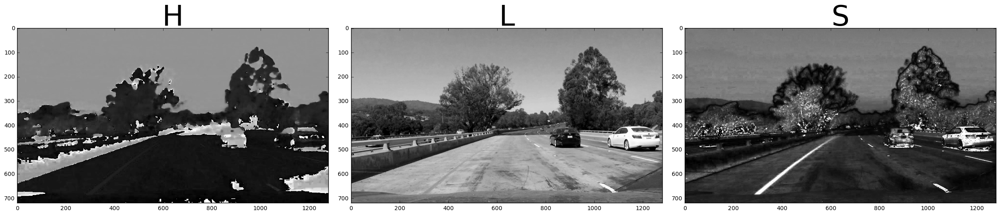

In [9]:
test1_hls = cv2.cvtColor(test1_image, cv2.COLOR_RGB2HLS)

plot_gray_images([[test1_hls[:,:,0], 'H'], [test1_hls[:,:,1], 'L'], [test1_hls[:,:,2], 'S']])

In [10]:
# Use color transforms, gradients, etc., to create a thresholded binary image.

def abs_sobel_threshold(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    """Apply Sobel transformation to image"""
    
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
#    gray = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
#    gray = gray[:,:,2]

    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel))

    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255 * abs_sobel / np.max(abs_sobel))
    
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)

    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    return binary_output


def mag_threshold(img, sobel_kernel=3, thresh=(0, 255)):
    """Apply magnitute threshold"""

    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
#    gray = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
#    gray = img[:,:,2]
    
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= thresh[0]) & (gradmag <= thresh[1])] = 1

    return binary_output


def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    """Apply direction threshold"""
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
#    gray = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
#    gray = img[:,:,2]
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    return binary_output

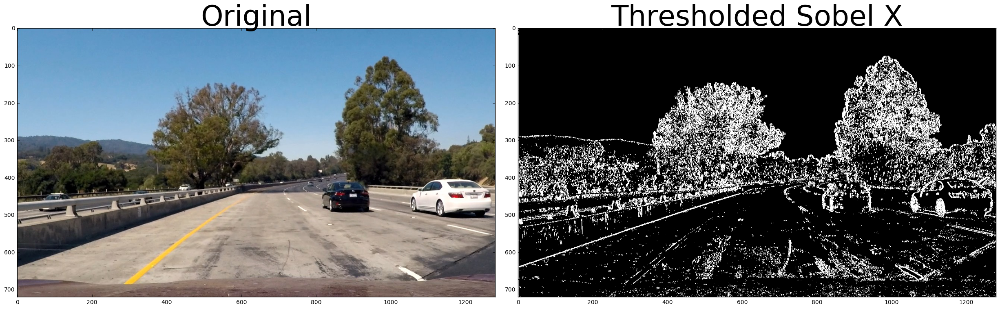

In [11]:
test1_image = mpimg.imread('test_images/test1.jpg')
test1_sobel = abs_sobel_threshold(test1_image, orient='x', sobel_kernel=3, thresh=(10, 255))
# Diplay original and thresholded gradient (Sobel) image
plot_images([[test1_image, 'Original'], [test1_sobel, 'Thresholded Sobel X']])

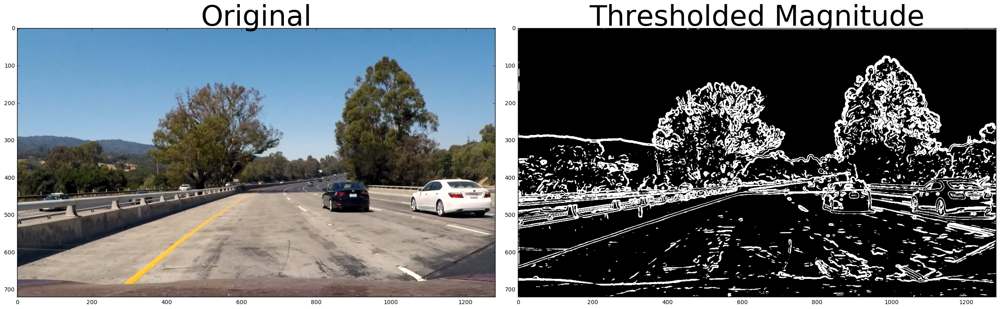

In [12]:
test1_image = mpimg.imread('test_images/test1.jpg')
test1_mag = mag_threshold(test1_image, sobel_kernel=15, thresh=(25, 100))
# Diplay original and thresholded gradient (Mag) image
plot_images([[test1_image, 'Original'], [test1_mag, 'Thresholded Magnitude']])

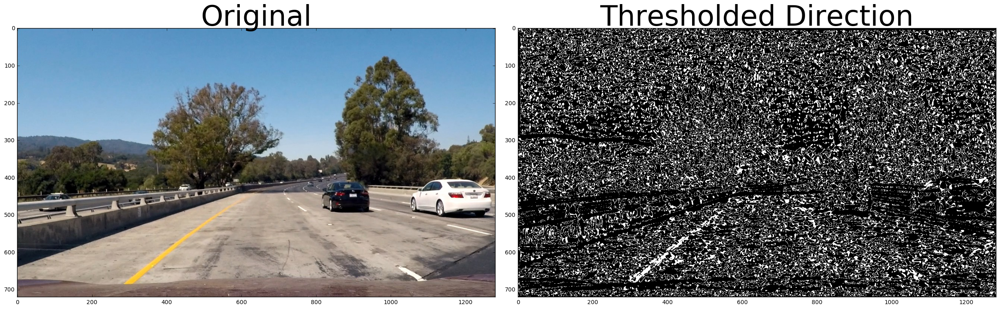

In [13]:
test1_image = mpimg.imread('test_images/test1.jpg')
test1_dir = dir_threshold(test1_image, sobel_kernel=19, thresh=(0.7, 1.1))
# Diplay original and thresholded gradient (Dir) image
plot_images([[test1_image, 'Original'], [test1_dir, 'Thresholded Direction']])

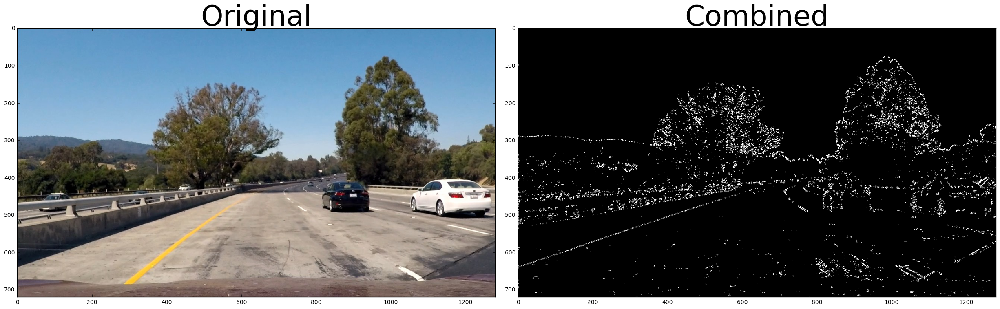

In [14]:
test1_image = mpimg.imread('test_images/test1.jpg')

# Choose a Sobel kernel size
ksize = 3 # Choose a larger odd number to smooth gradient measurements

# Apply each of the thresholding functions
gradx = abs_sobel_threshold(test1_image, orient='x', sobel_kernel=ksize, thresh=(20, 100))
grady = abs_sobel_threshold(test1_image, orient='y', sobel_kernel=ksize, thresh=(20, 100))
mag_binary = mag_threshold(test1_image, sobel_kernel=ksize, thresh=(30, 100))
dir_binary = dir_threshold(test1_image, sobel_kernel=15, thresh=(0.7, 1.1))

test1_combined = np.zeros_like(mag_binary)
test1_combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1

plot_images([[test1_image, 'Original'], [test1_combined, 'Combined']])

In [15]:
def saturation_threshold(image, thresh=(0, 255)):
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    
    binary_output = np.zeros_like(S)
    binary_output[(S > thresh[0]) & (S <= thresh[1])] = 1
    
    return binary_output

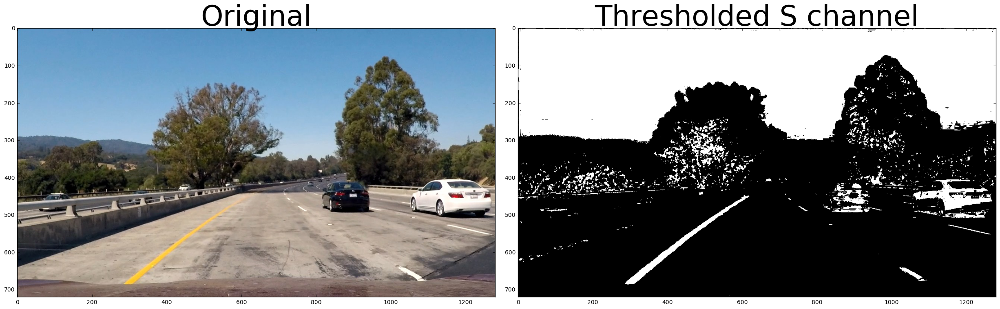

In [16]:
test1_image = mpimg.imread('test_images/test1.jpg')

test1_s_binary = saturation_threshold(test1_image, thresh=(110, 255))

# Diplay original and thresholded gradient (Sobel) image
plot_images([[test1_image, 'Original'], [test1_s_binary, 'Thresholded S channel']])

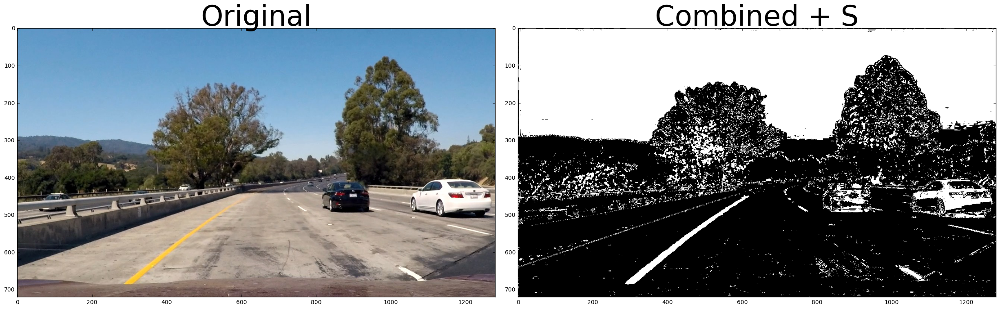

In [17]:
# Combine color and gradient threshold
test1_combined_2 = np.zeros_like(test1_combined)
test1_combined_2[(test1_combined == 1) | (test1_s_binary == 1)] = 1

plot_images([[test1_image, 'Original'], [test1_combined_2, 'Combined + S']])

In [18]:
# Threshold pipeline
def pipeline(img, s_thresh=(0, 255), sx_thresh=(0, 255)):
    img = np.copy(img)
    # Convert to HSV color space and separate the V channel
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    r_channel = img[:,:,0]
    l_channel = hsv[:,:,1]
    s_channel = hsv[:,:,2]

    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255 * abs_sobelx / np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
    
    #color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary))
    
    binary_pipeline = np.zeros_like(sxbinary)
    binary_pipeline[(sxbinary == 1) | (s_binary == 1)] = 1
    return binary_pipeline

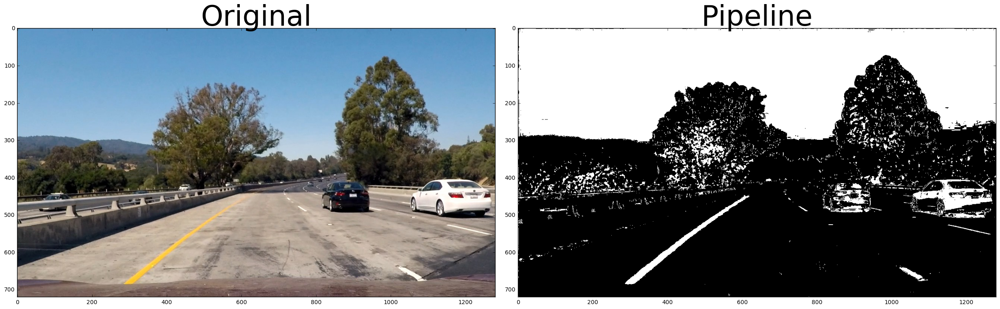

In [19]:
test1_pipeline = pipeline(test1_image, s_thresh=(110, 255), sx_thresh=(55, 100))
# Diplay original and thresholded gradient (Sobel) image
plot_images([[test1_image, 'Original'], [test1_pipeline, 'Pipeline']])

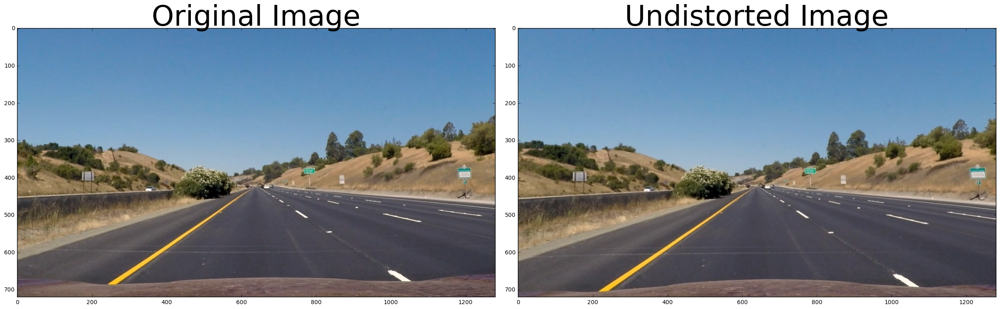

In [20]:
# Perspective transform
# %matplotlib qt
straight1_image = mpimg.imread('test_images/straight_lines1.jpg')
straight1_undist = apply_correction(straight1_image, objpoints, imgpoints)
# Display original an undistorted images
plot_images([[straight1_image, 'Original Image'], [straight1_undist, 'Undistorted Image']])

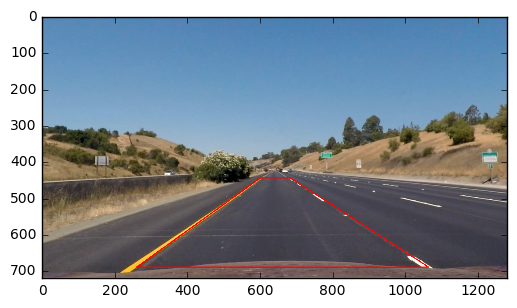

In [21]:
# 682x445, 1062x690 | 260x690, 600x445
# 695x460, 1127x720 | 203x720, 585x460
# %matplotlib inline
plt.imshow(straight1_undist)
plt.xlim(0, 1280)
plt.ylim(720, 0)
#plt.plot([585, 695], [460, 460], color='red', linewidth=3)
#plt.plot([695, 1127], [460, 720], color='red', linewidth=3)
#plt.plot([1127, 203], [720, 720], color='red', linewidth=3)
#plt.plot([203, 585], [720, 460], color='red', linewidth=3)

cv2.line(straight1_undist, (600,445), (682,445), (255,0,0), 2)
cv2.line(straight1_undist, (682,445), (1062,690), (255,0,0), 2)
cv2.line(straight1_undist, (1062,690), (260,690), (255,0,0), 2)
cv2.line(straight1_undist, (260,690), (600,445), (255,0,0), 2)

plt.imsave('test_images/test_perspective_line.jpg', straight1_undist)

In [22]:
def perspective_transform(img):
    """Return perspective transform matrix"""
    # source points 682x445, 1062x690 | 260x690, 600x445
    src = np.float32([[682,445], [1062,690], [260,690], [600,445]])
    
    # destination points
    dst = np.float32([[938, 0], [938, 720], [367, 720], [367, 0]])

    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    
    # Compute inverse perspective transform matrix
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    return M, Minv

def warp_perspective(img, M):
    """Warp image using the given perspective transform matrix"""
    img_size = (img.shape[1], img.shape[0])
    
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(img, M, img_size)
    
    return warped

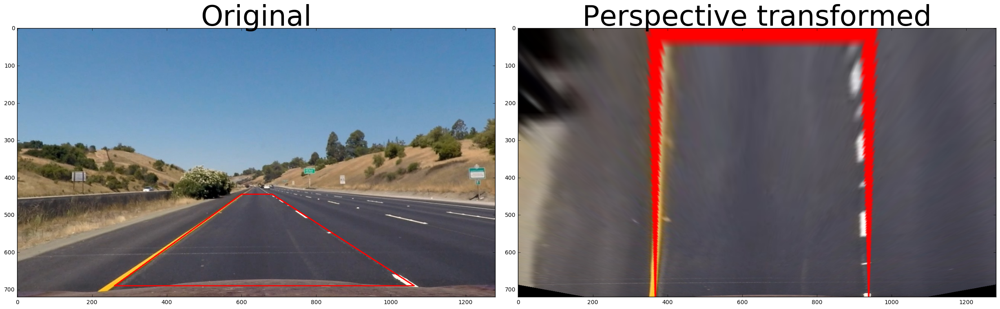

In [23]:
M, Minv = perspective_transform(straight1_undist)
straight1_perspective = warp_perspective(straight1_undist, M)

# Display original an warp perspective transformed image
plot_images([[straight1_undist, 'Original'], [straight1_perspective, 'Perspective transformed']])

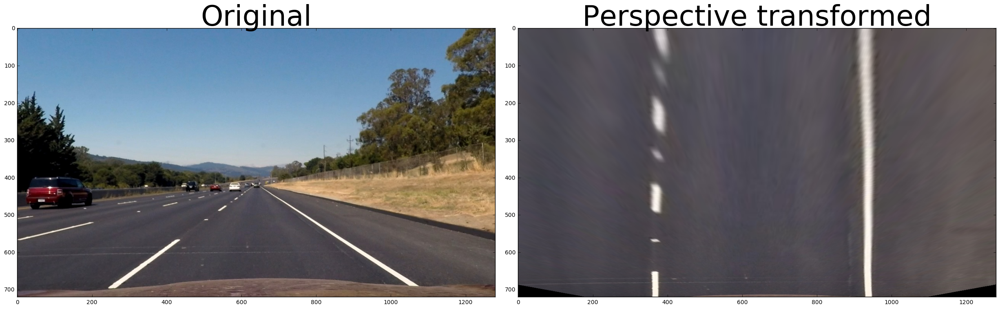

In [24]:
straight2_image = mpimg.imread('test_images/straight_lines2.jpg')
straight2_undistorted = apply_correction(straight2_image, objpoints, imgpoints)
straight2_perspective = warp_perspective(straight2_undistorted.astype(np.uint8), M)
plot_images([[straight2_undistorted, 'Original'], [straight2_perspective, 'Perspective transformed']])

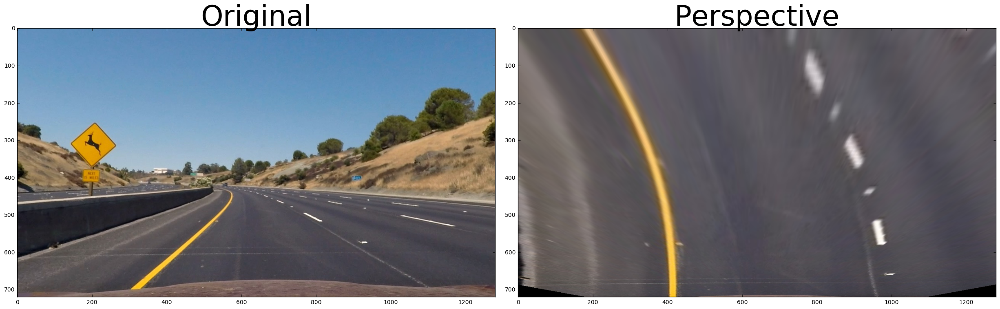

In [25]:
test2_image = mpimg.imread('test_images/test2.jpg')
test2_undistored = apply_correction(test2_image, objpoints, imgpoints)
test2_perspective = warp_perspective(test2_undistored, M)
plot_images([[test2_undistored, 'Original'], [test2_perspective, 'Perspective']])

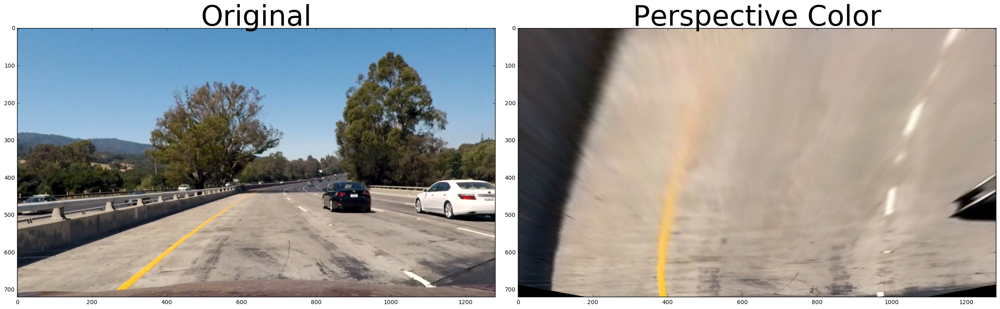

In [26]:
test1_image = mpimg.imread('test_images/test1.jpg')
test1_undist = apply_correction(test1_image, objpoints, imgpoints)
test1_perspective_color = warp_perspective(test1_undist, M)
plot_images([[test1_undist, 'Original'], [test1_perspective_color, 'Perspective Color']])

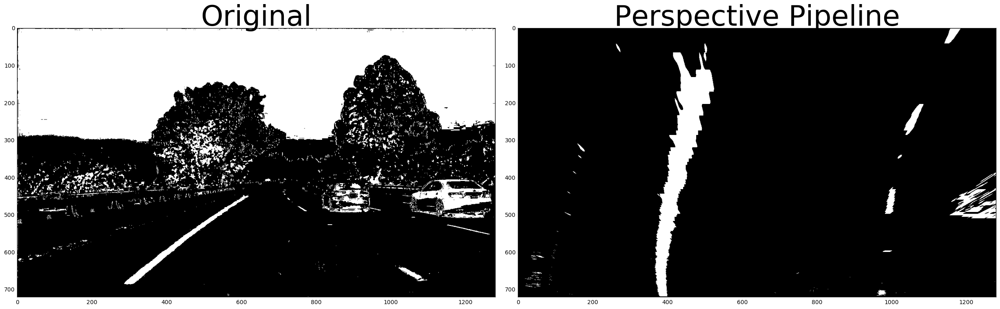

In [27]:
test1_perspective = warp_perspective(test1_pipeline, M)
plot_gray_two_images([[test1_pipeline, 'Original'], [test1_perspective, 'Perspective Pipeline']])

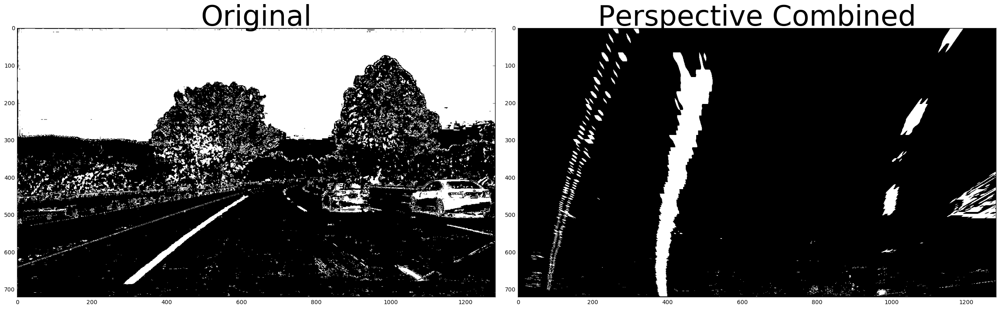

In [28]:
test1_perspective_combined = warp_perspective(test1_combined_2, M)
plot_gray_two_images([[test1_combined_2, 'Original'], [test1_perspective_combined, 'Perspective Combined']])

In [29]:
def fit_lines(binary_warped):
    """Fit left and right lines."""
    
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    l_r_margin = 200
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[l_r_margin:midpoint]) + l_r_margin
    rightx_base = np.argmax(histogram[midpoint:-l_r_margin]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    return left_fit, right_fit, out_img


def visualize(out_img, left_fit, right_fit):
    # Generate x and y values for plotting
    ploty = np.linspace(0, out_img.shape[0]-1, out_img.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    #out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    #out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    plt.imshow(out_img)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)

/Users/bogdan/anaconda/envs/sdc/lib/python3.5/site-packages/ipykernel/__main__.py:5: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


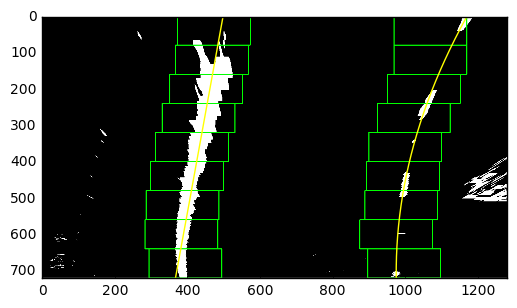

In [30]:
left_fit, right_fit, out_img = fit_lines(test1_perspective)
visualize(out_img, left_fit, right_fit)

/Users/bogdan/anaconda/envs/sdc/lib/python3.5/site-packages/ipykernel/__main__.py:5: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


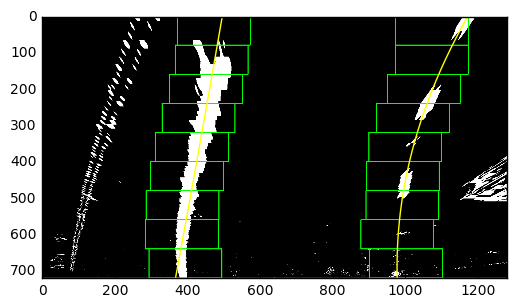

In [31]:
left_fit, right_fit, out_img = fit_lines(test1_perspective_combined)
visualize(out_img, left_fit, right_fit)

In [32]:
def fit_lines_second_frame(binary_warped, left_fit, right_fit):
    # Assume you now have a new warped binary image 
    # from the next frame of video
    # It's now much easier to find line pixels!
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    return left_fit, right_fit

def visualize_second_frame(binary_warped, left_fit, right_fit, margin=100):
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    #out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    #out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    plt.imshow(result)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)

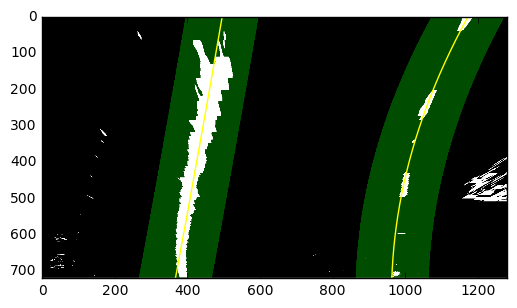

In [33]:
left_fit, right_fit = fit_lines_second_frame(test1_perspective_combined, left_fit, right_fit)
visualize_second_frame(test1_perspective, left_fit, right_fit)

In [34]:
def curvature(warped, fit):
    """Measure curvature"""
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30.0 / 720 # meters per pixel in y dimension
    xm_per_pix =  3.7 / 700 # meters per pixel in x dimension

    ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0] )
    fitx  = fit[0]*ploty**2 + fit[1]*ploty + fit[2]

    y_eval = np.max(ploty)
    
    # Fit new polynomials to x,y in world space
    fit_cr  = np.polyfit(ploty*ym_per_pix, fitx*xm_per_pix, 2)
    
    # Calculate the new radii of curvature
    curverad = ((1 + (2*fit_cr[0]*y_eval*ym_per_pix + fit_cr[1])**2)**1.5) / np.absolute(2*fit_cr[0])
    
    return int(curverad)

In [35]:
print( curvature(test1_perspective, left_fit) )
print( curvature(test1_perspective, right_fit) )

17862
460


In [36]:
def vehicle_position(lx, rx, maxx):
    xm_per_pix = 3.7 / 700 # meters per pixel in x dimension
    return "{0:.2f}".format(abs(maxx/2 - (lx + rx) / 2) * xm_per_pix)
    
def draw_lines(undist, warped, left_fit, right_fit, Minv):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    ploty = np.linspace(0, undist.shape[0]-1, undist.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (warped.shape[1], warped.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
    # Vehicle position
    position = vehicle_position(left_fitx[undist.shape[0] - 1], right_fitx[undist.shape[0] - 1], undist.shape[1])
    
    return result, position

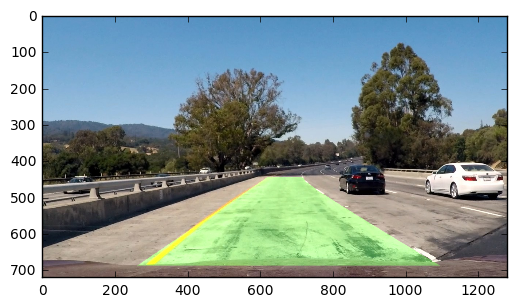

In [37]:
result, position = draw_lines(test1_image, test1_perspective, left_fit, right_fit, Minv)
plt.imshow(result)

In [38]:
current_frame_number = 1
last_left_fit = None
last_right_fit = None

def draw_full_pipeline(img, average=True):
    global objpoints, imgpoints, Minv, current_frame_number
    global last_left_fit, last_right_fit
    
    # 2. Apply correction
    img = apply_correction(img, objpoints, imgpoints)
    # 3. Pipeline - binary threshold
    img_binary = pipeline(img, s_thresh=(150, 200), sx_thresh=(20, 100))
    # 4. Perspective transform
    img_perspective = warp_perspective(img_binary, M)
    # 5. Fit lines
    left_fit, right_fit, out_img = fit_lines(img_perspective)
    if last_left_fit != None and average == True:
        left_fit = 0.9 * last_left_fit + 0.1 * left_fit
        right_fit = 0.9 * last_right_fit + 0.1 * right_fit
    last_left_fit  = left_fit
    last_right_fit = right_fit
        
    # 6. Get curvature
    curv_left = curvature(img_perspective, left_fit)
    curv_right = curvature(img_perspective, right_fit)
    
    # 7. Draw lines
    result, position = draw_lines(img, img_perspective, left_fit, right_fit, Minv)
    # 8. Write radius of curvature
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(result, 'Radius: ' + str(np.mean([curv_left, curv_right])) + "m", (30, 70), font, 1, (255,255,255), 2)
    # 9. Write position
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(result, 'Center offset: ' + str(position) + "m", (30, 120), font, 1, (255,255,255), 2)
    
    # 10. Save frames for test
    plt.imsave('output_videos/frames/'+str(current_frame_number)+'.jpg', img)
    plt.imsave('output_videos/frames/'+str(current_frame_number)+'_transformed.jpg', result)
    current_frame_number += 1
    
    return result

/Users/bogdan/anaconda/envs/sdc/lib/python3.5/site-packages/ipykernel/__main__.py:5: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/Users/bogdan/anaconda/envs/sdc/lib/python3.5/site-packages/ipykernel/__main__.py:17: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


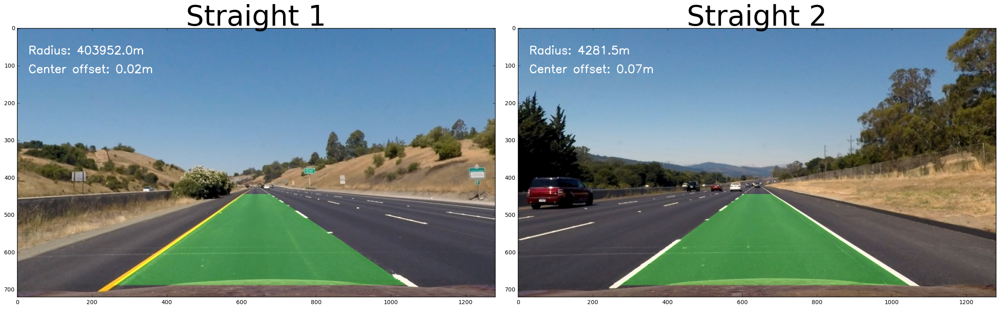

In [39]:
# Test on straight_lines1 & straight_lines2
img1 = draw_full_pipeline(mpimg.imread('test_images/straight_lines1.jpg'), False)
img2= draw_full_pipeline(mpimg.imread('test_images/straight_lines2.jpg'), False)

plot_images([[img1, 'Straight 1'], [img2, 'Straight 2']])

/Users/bogdan/anaconda/envs/sdc/lib/python3.5/site-packages/ipykernel/__main__.py:5: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/Users/bogdan/anaconda/envs/sdc/lib/python3.5/site-packages/ipykernel/__main__.py:17: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


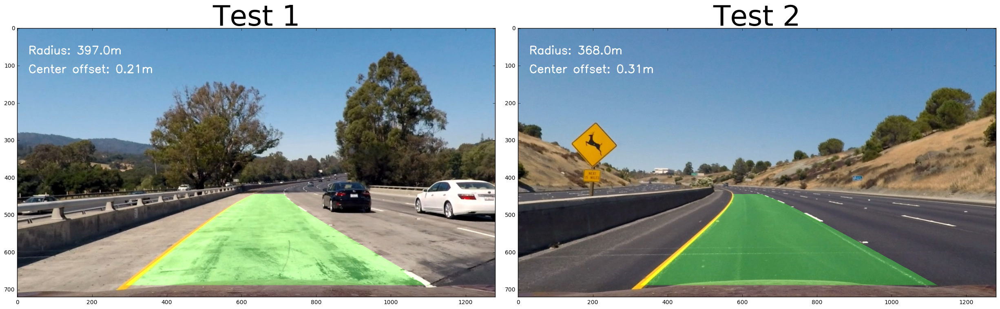

In [40]:
# Test on test1 & test2
img1 = draw_full_pipeline(mpimg.imread('test_images/test1.jpg'), False)
img2 = draw_full_pipeline(mpimg.imread('test_images/test2.jpg'), False)

plot_images([[img1, 'Test 1'], [img2, 'Test 2']])

/Users/bogdan/anaconda/envs/sdc/lib/python3.5/site-packages/ipykernel/__main__.py:5: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/Users/bogdan/anaconda/envs/sdc/lib/python3.5/site-packages/ipykernel/__main__.py:17: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


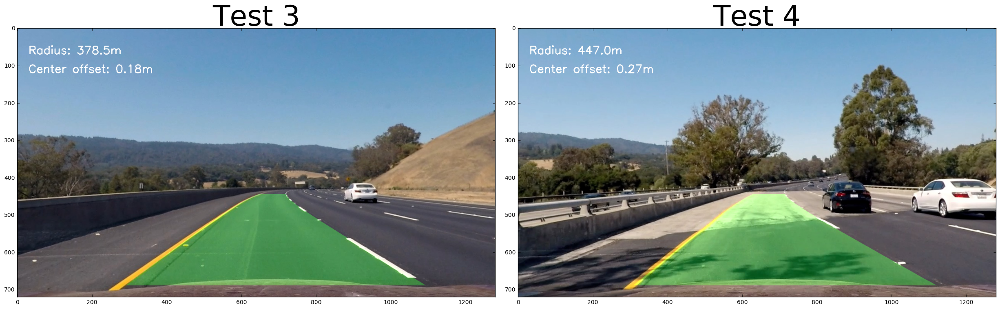

In [41]:
# Test on test3 & test4
img1 = draw_full_pipeline(mpimg.imread('test_images/test3.jpg'), False)
img2 = draw_full_pipeline(mpimg.imread('test_images/test4.jpg'), False)

plot_images([[img1, 'Test 3'], [img2, 'Test 4']])

/Users/bogdan/anaconda/envs/sdc/lib/python3.5/site-packages/ipykernel/__main__.py:5: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/Users/bogdan/anaconda/envs/sdc/lib/python3.5/site-packages/ipykernel/__main__.py:17: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


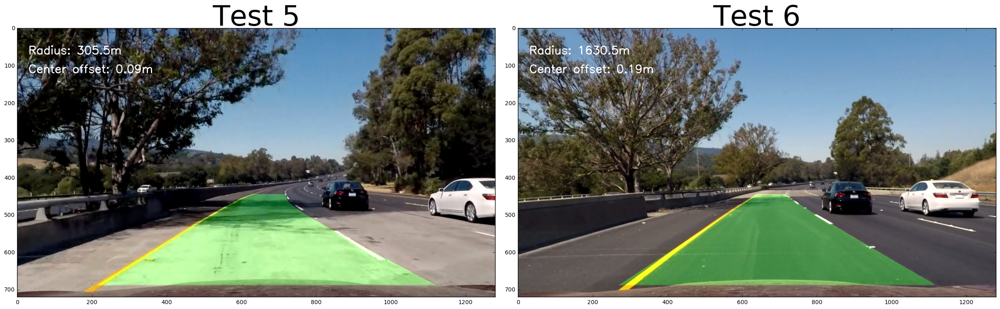

In [42]:
# Test on test5 & test6
img1 = draw_full_pipeline(mpimg.imread('test_images/test5.jpg'), False)
img2 = draw_full_pipeline(mpimg.imread('test_images/test6.jpg'), False)

plot_images([[img1, 'Test 5'], [img2, 'Test 6']])

/Users/bogdan/anaconda/envs/sdc/lib/python3.5/site-packages/ipykernel/__main__.py:5: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


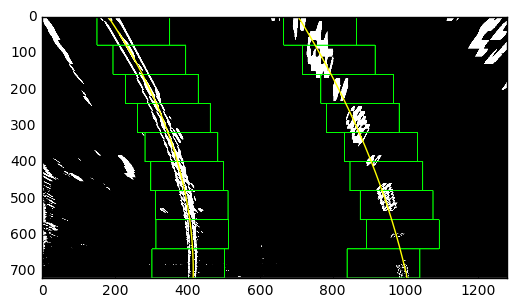

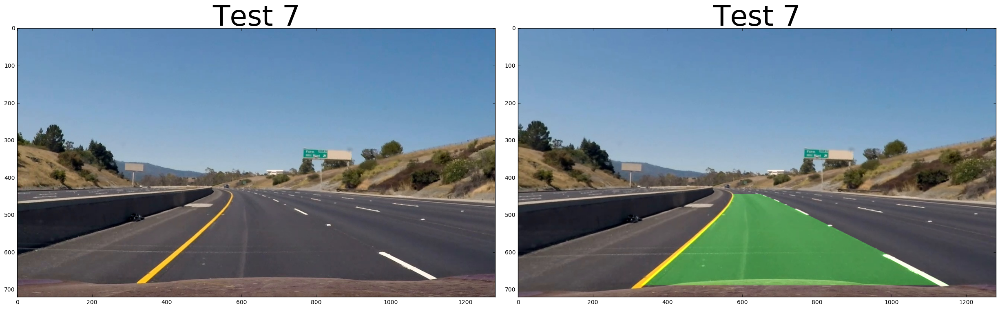

In [43]:
def draw_full_pipeline_test(img):
    global objpoints, imgpoints, Minv

    # 1. Load image
    #straight_lines1 = mpimg.imread('test_images/straight_lines1.jpg')
    # 2. Apply correction
    img = apply_correction(img, objpoints, imgpoints)
    # 3. Pipeline - binary threshold
    img_binary = pipeline(img, s_thresh=(150, 200), sx_thresh=(20, 100))

    # 4. Perspective transform
    img_perspective = warp_perspective(img_binary, M)
    # 5. Fit lines
    left_fit, right_fit, out_img = fit_lines(img_perspective)
    visualize(out_img, left_fit, right_fit)
    
    # 6. Draw lane
    result, position = draw_lines(img, img_perspective, left_fit, right_fit, Minv)
    
    return result

# Test on test1 & test4
img1 = mpimg.imread('test_images/test7.jpg')
img2 = draw_full_pipeline_test(img1)

plot_images([[img1, 'Test 7'], [img2, 'Test 7']])

In [44]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [ ]:
current_frame_number = 1
last_left_fit = None
last_right_fit = None
output_video = 'output_videos/project_video.mp4'
clip1 = VideoFileClip("test_videos/project_video.mp4")
output_clip = clip1.fl_image(draw_full_pipeline)
%time output_clip.write_videofile(output_video, audio=False)

In [ ]:
current_frame_number = 1
last_left_fit = None
last_right_fit = None
output_video = 'output_videos/challenge_video.mp4'
clip1 = VideoFileClip("test_videos/challenge_video.mp4")
output_clip = clip1.fl_image(draw_full_pipeline)
%time output_clip.write_videofile(output_video, audio=False)

In [ ]:
current_frame_number = 1
last_left_fit = None
last_right_fit = None
output_video = 'output_videos/harder_challenge_video.mp4'
clip1 = VideoFileClip("test_videos/harder_challenge_video.mp4")
output_clip = clip1.fl_image(draw_full_pipeline)
%time output_clip.write_videofile(output_video, audio=False)